##  How Transformations Work?

From The Transfer Learning Tutorial Section,
```
data_transforms = {
    'train': transforms.Compose([
        transforms.RandomResizedCrop(224),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'val': transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}
```

 <b>The transforms operations are always applied to your original images at every batch generation(depends on your batch size). So your dataset is always left unchanged, only the batch images are copied and transformed every iteration.. </b> </font>


```data_transforms['train'] is basically doing this ```

- Randomly resize the provided image and randomly crop it to obtain a (224, 224) patch.
- Apply or not a random horizontal flip to this patch, with a 50/50 chance.(default probability)
- Convert it to a Tensor.
- Normalize the resulting Tensor, given the mean and deviation values you provided.

```data_transforms['val'] is basically doing this ```

- Resize your image to (256, 256)
- Center crop the resized image to obtain a (224, 224) patch
- Convert it to a Tensor
- Normalize the resulting Tensor, given the mean and deviation values you provided

## Download the data and import dependencies

In [0]:
!pip install torch==0.4.0 torchvision pillow==5.1.0
!wget https://s3.amazonaws.com/content.udacity-data.com/courses/nd188/flower_data.zip
!wget -O google_test_data.zip "https://www.dropbox.com/s/3zmf1kq58o909rq/google_test_data.zip?dl=1"
!unzip -qq google_test_data.zip -d ./google_data
!unzip -qq flower_data.zip

In [0]:
!wget https://s3.amazonaws.com/content.udacity-data.com/courses/nd188/flower_data.zip
!wget -O google_test_data.zip "https://www.dropbox.com/s/3zmf1kq58o909rq/google_test_data.zip?dl=1"
!unzip -qq google_test_data.zip -d ./google_data
!unzip -qq flower_data.zip# we will verify that GPU is enabled for this notebook
# following should print: CUDA is available!  Training on GPU ...
# 
# if it prints otherwise, then you need to enable GPU: 
# from Menu > Runtime > Change Runtime Type > Hardware Accelerator > GPU

import torch
import numpy as np

# check if CUDA is available
train_on_gpu = torch.cuda.is_available()

if not train_on_gpu:
    print('CUDA is not available.  Training on CPU ...')
else:
    print('CUDA is available!  Training on GPU ...')

In [0]:
import numpy as np, torch
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import PIL

import matplotlib.pyplot as plt
%matplotlib inline

import matplotlib as mpl
mpl.rcParams['axes.grid'] = False
mpl.rcParams['image.interpolation'] = 'nearest'
mpl.rcParams['figure.figsize'] = 15, 25

#this is a fix to ignore import errors #copy pasted from StackOverflow..
from PIL import Image
def register_extension(id, extension): Image.EXTENSION[extension.lower()] = id.upper()
Image.register_extension = register_extension
def register_extensions(id, extensions): 
  for extension in extensions: register_extension(id, extension)
Image.register_extensions = register_extensions

# Test different transformations

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  from ipykernel import kernelapp as app


(1408, 3200, 3)
tensor([[[[ 0.0000,  0.0235,  0.1569,  ...,  0.1608,  0.1647,  0.1529],
          [ 0.0000,  0.0275,  0.1333,  ...,  0.1647,  0.1608,  0.1569],
          [ 0.0000,  0.0314,  0.0784,  ...,  0.1725,  0.1725,  0.1725],
          ...,
          [ 0.0039,  0.0000,  0.0000,  ...,  0.8549,  0.8510,  0.8510],
          [ 0.0078,  0.0039,  0.0000,  ...,  0.7176,  0.7216,  0.7176],
          [ 0.0118,  0.0078,  0.0039,  ...,  0.6118,  0.6510,  0.6039]],

         [[ 0.1843,  0.1529,  0.2039,  ...,  0.3451,  0.3490,  0.3373],
          [ 0.1725,  0.1490,  0.1843,  ...,  0.3490,  0.3451,  0.3412],
          [ 0.1647,  0.1451,  0.1255,  ...,  0.3569,  0.3569,  0.3569],
          ...,
          [ 0.0824,  0.0784,  0.0745,  ...,  0.8039,  0.8039,  0.7922],
          [ 0.0784,  0.0745,  0.0706,  ...,  0.7137,  0.7059,  0.6863],
          [ 0.0784,  0.0745,  0.0706,  ...,  0.6627,  0.6824,  0.6078]],

         [[ 0.1765,  0.1569,  0.2235,  ...,  0.1725,  0.1804,  0.1647],
          [ 0.

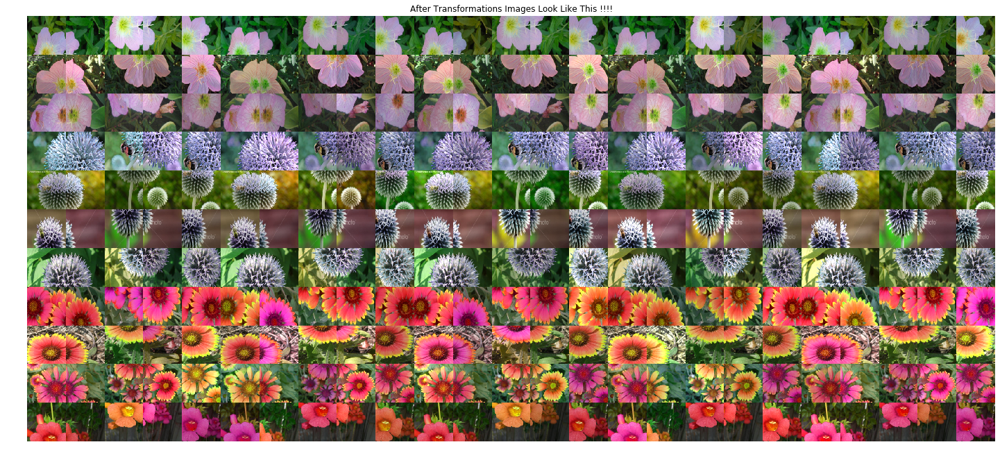

In [4]:
## Five Crop

data_transforms_playground = {
    'train': transforms.Compose([
    transforms.Resize((224,224)),
    transforms.ColorJitter(brightness = .2, hue=.10),
    transforms.FiveCrop(128),
    transforms.Lambda(lambda crops: torch.stack([transforms.ToTensor()(crop) for crop in crops]))
    ])
}


def show_dataset(dataset, n=10):
  mpl.rcParams['figure.figsize'] = 25, 50
  _, ax = plt.subplots()
  imgs = np.vstack(np.hstack(np.hstack((np.asarray(dataset[i][0][k]).transpose((1,2,0)) for k in range(5))) for _ in range(n)) for i in range(1,102,10))
  print(imgs.shape)
  plt.imshow(imgs)
  ax.set_title('After Transformations Images Look Like This !!!!')
  plt.axis('off')
  
dataset = torchvision.datasets.ImageFolder('flower_data/train/', transform=data_transforms_playground['train'])

show_dataset(dataset,5)
print(dataset[0][0])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  


(2464, 5600, 3)


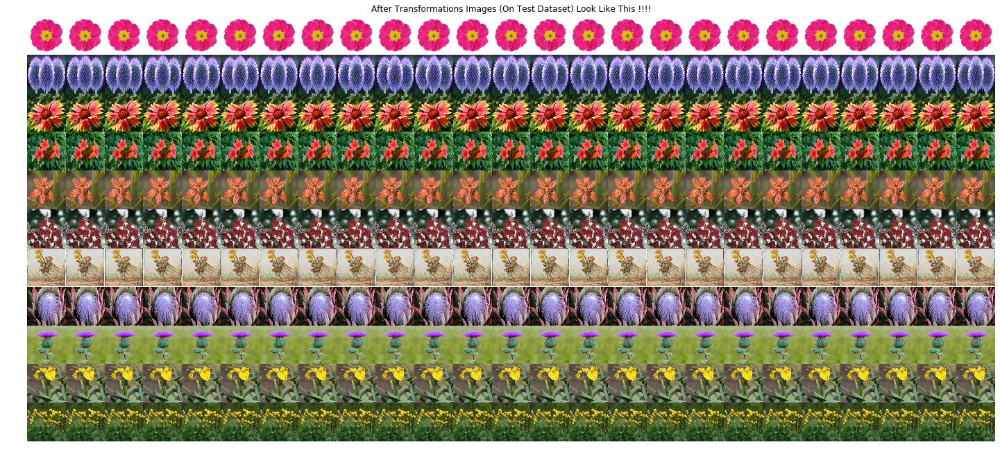

In [5]:
## Five Crop

data_transforms_playground = {
    'train': transforms.Compose([
    transforms.Resize((224,224)),
    transforms.FiveCrop(224),
    transforms.Lambda(lambda crops: torch.stack([transforms.ToTensor()(crop) for crop in crops]))
    ])
}


def show_dataset(dataset, n=10):
  mpl.rcParams['figure.figsize'] = 25, 50
  _, ax = plt.subplots()
  imgs = np.vstack(np.hstack(np.hstack((np.asarray(dataset[i][0][k]).transpose((1,2,0)) for k in range(5))) for _ in range(n)) for i in range(1,102,10))
  print(imgs.shape)
  plt.imshow(imgs)
  ax.set_title('After Transformations Images (On Test Dataset) Look Like This !!!!')
  plt.axis('off')
  
dataset = torchvision.datasets.ImageFolder('google_data/', transform=data_transforms_playground['train'])

show_dataset(dataset,5)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  app.launch_new_instance()


(2000, 5000, 3)


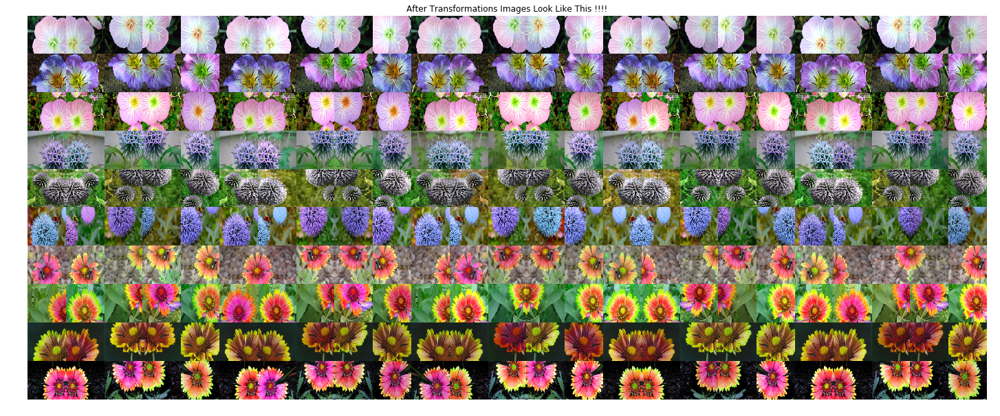

In [6]:
## Five Crop with Flip

data_transforms_playground = {
    'train': transforms.Compose([
    transforms.Resize((299,299)),
    transforms.ColorJitter(brightness = .1, hue=.1),
    transforms.RandomHorizontalFlip(.75),
    transforms.FiveCrop(200),
    transforms.Lambda(lambda crops: torch.stack([transforms.ToTensor()(crop) for crop in crops]))
    ])
}


def show_dataset(dataset, n=10):
  mpl.rcParams['figure.figsize'] = 25, 50
  _, ax = plt.subplots()
  imgs = np.vstack(np.hstack(np.hstack((np.asarray(dataset[i][0][k]).transpose((1,2,0)) for k in range(5))) for _ in range(n)) for i in range(5,102,10))
  print(imgs.shape)
  plt.imshow(imgs)
  ax.set_title('After Transformations Images Look Like This !!!!')
  plt.axis('off')
  
dataset = torchvision.datasets.ImageFolder('flower_data/train/', transform=data_transforms_playground['train'])

show_dataset(dataset,5)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  app.launch_new_instance()


(2000, 5000, 3)


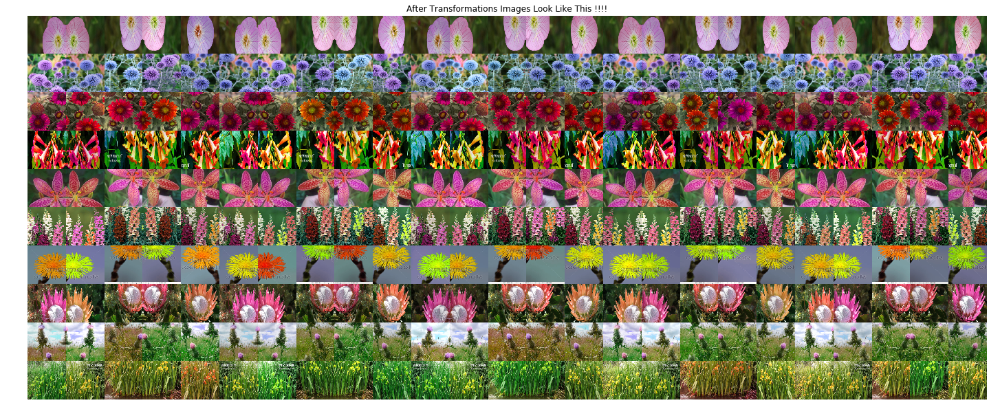

In [7]:
## Five Crop with Flip

data_transforms_playground = {
    'train': transforms.Compose([
    transforms.Resize((299,299)),
    transforms.ColorJitter(brightness = .1, hue=.1),
    transforms.RandomHorizontalFlip(.75),
    transforms.FiveCrop(200),
    transforms.Lambda(lambda crops: torch.stack([transforms.ToTensor()(crop) for crop in crops]))
    ])
}


def show_dataset(dataset, n=10):
  mpl.rcParams['figure.figsize'] = 25, 50
  _, ax = plt.subplots()
  imgs = np.vstack(np.hstack(np.hstack((np.asarray(dataset[i][0][k]).transpose((1,2,0)) for k in range(5))) for _ in range(n)) for i in range(5,102,10))
  print(imgs.shape)
  plt.imshow(imgs)
  ax.set_title('After Transformations Images Look Like This !!!!')
  plt.axis('off')
  
dataset = torchvision.datasets.ImageFolder('google_data/', transform=data_transforms_playground['train'])

show_dataset(dataset,5)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  


(2464, 2240, 3)


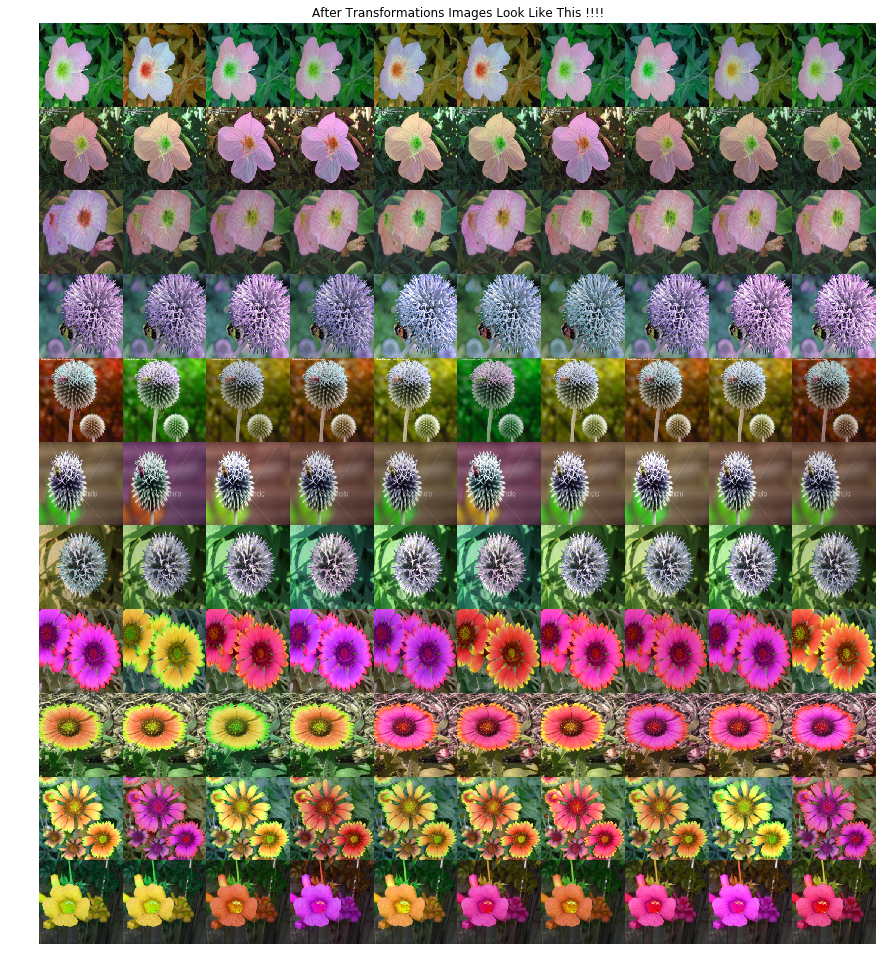

In [8]:
mpl.rcParams['figure.figsize'] = 15, 25

data_transforms_playground = {
    'train': transforms.Compose([
    transforms.Resize((224,224)),
    transforms.ColorJitter(brightness = .1, hue=.18),
    ])
}


def show_dataset(dataset, n=10):
  _, ax = plt.subplots()
  imgs = np.vstack((np.hstack((np.asarray(dataset[i][0]) for _ in range(n)))
                   for i in range(1, 102, 10)))
  print(imgs.shape)
  plt.imshow(imgs)
  ax.set_title('After Transformations Images Look Like This !!!!')
  plt.axis('off')
  
dataset = torchvision.datasets.ImageFolder('flower_data/train/', transform=data_transforms_playground['train'])

show_dataset(dataset)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  


(2464, 2240, 3)


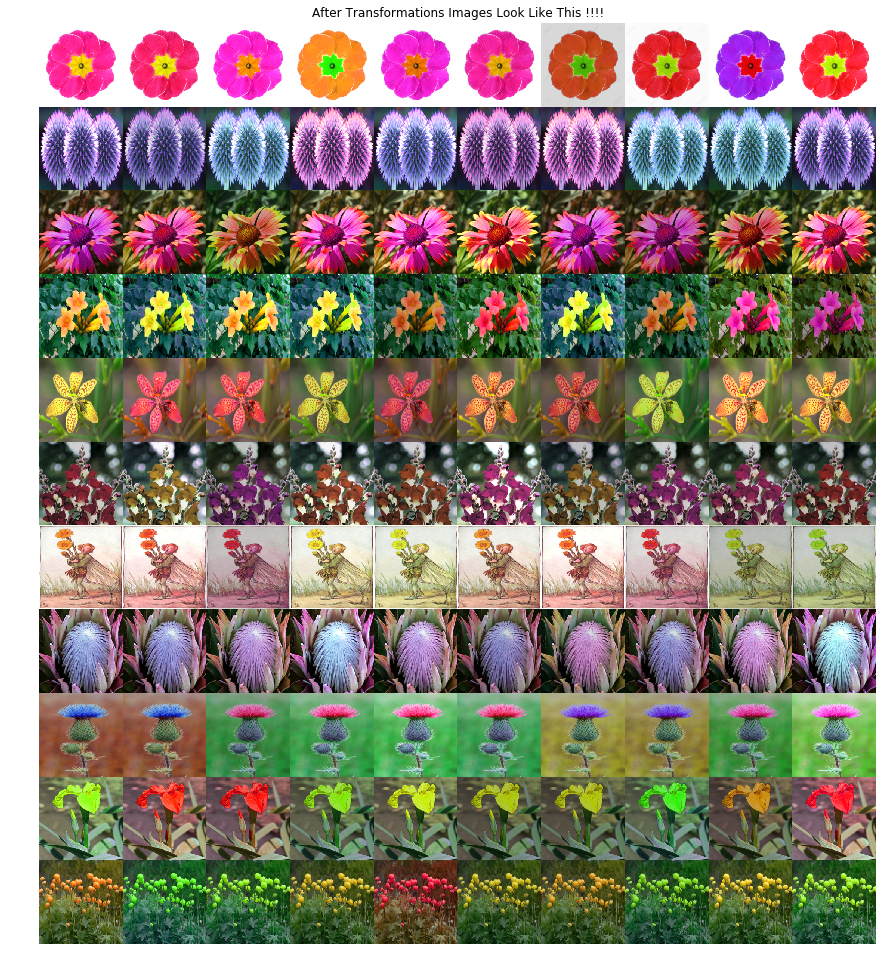

In [9]:
mpl.rcParams['figure.figsize'] = 15, 25

data_transforms_playground = {
    'train': transforms.Compose([
    transforms.Resize((224,224)),
    transforms.ColorJitter(brightness = .2, hue=.18),
    ])
}


def show_dataset(dataset, n=10):
  _, ax = plt.subplots()
  imgs = np.vstack((np.hstack((np.asarray(dataset[i][0]) for _ in range(n)))
                   for i in range(1, 102, 10)))
  print(imgs.shape)
  plt.imshow(imgs)
  ax.set_title('After Transformations Images Look Like This !!!!')
  plt.axis('off')
  
dataset = torchvision.datasets.ImageFolder('google_data/', transform=data_transforms_playground['train'])

show_dataset(dataset)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  from ipykernel import kernelapp as app


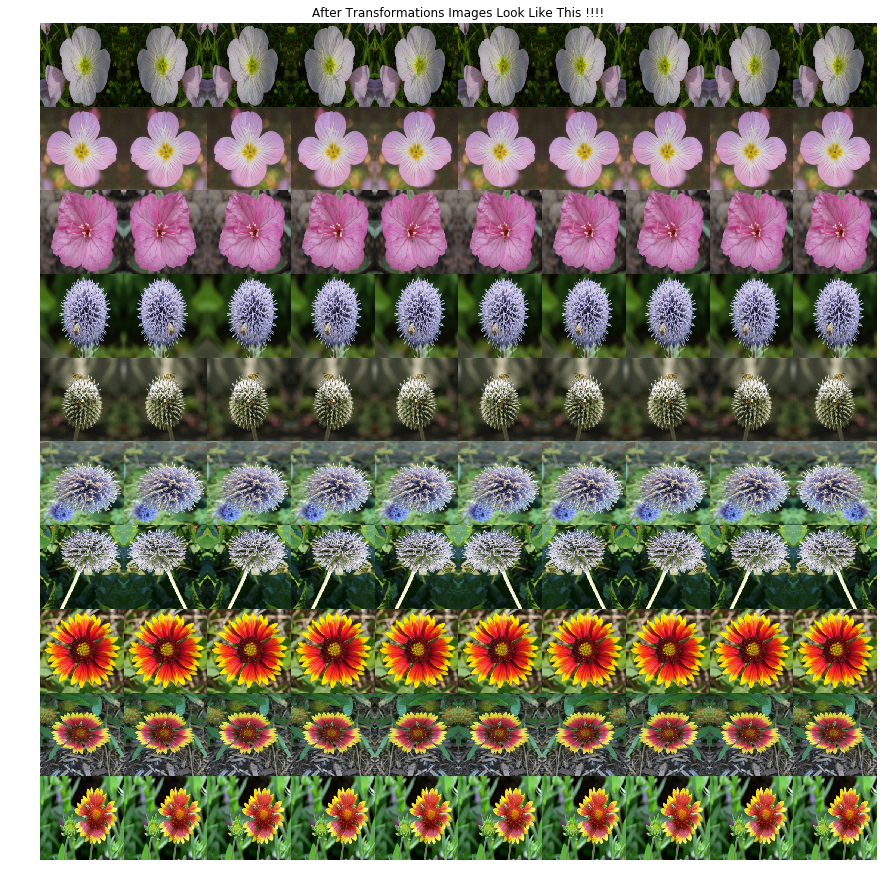

In [10]:
mpl.rcParams['figure.figsize'] = 15, 25

data_transforms_playground_2 = {
    'train': transforms.Compose([
    transforms.Resize((224,224)),
    transforms.RandomHorizontalFlip(.75)
    ])
}

dataset = torchvision.datasets.ImageFolder('flower_data/train/', transform=data_transforms_playground_2['train'])

def show_dataset(dataset, n=10):
  _, ax = plt.subplots()
  imgs = np.vstack((np.hstack((np.asarray(dataset[i][0]) for _ in range(n)))
                   for i in range(2, 102, 10)))
  plt.imshow(imgs)
  ax.set_title('After Transformations Images Look Like This !!!!')
  plt.axis('off')

  
show_dataset(dataset)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  from ipykernel import kernelapp as app


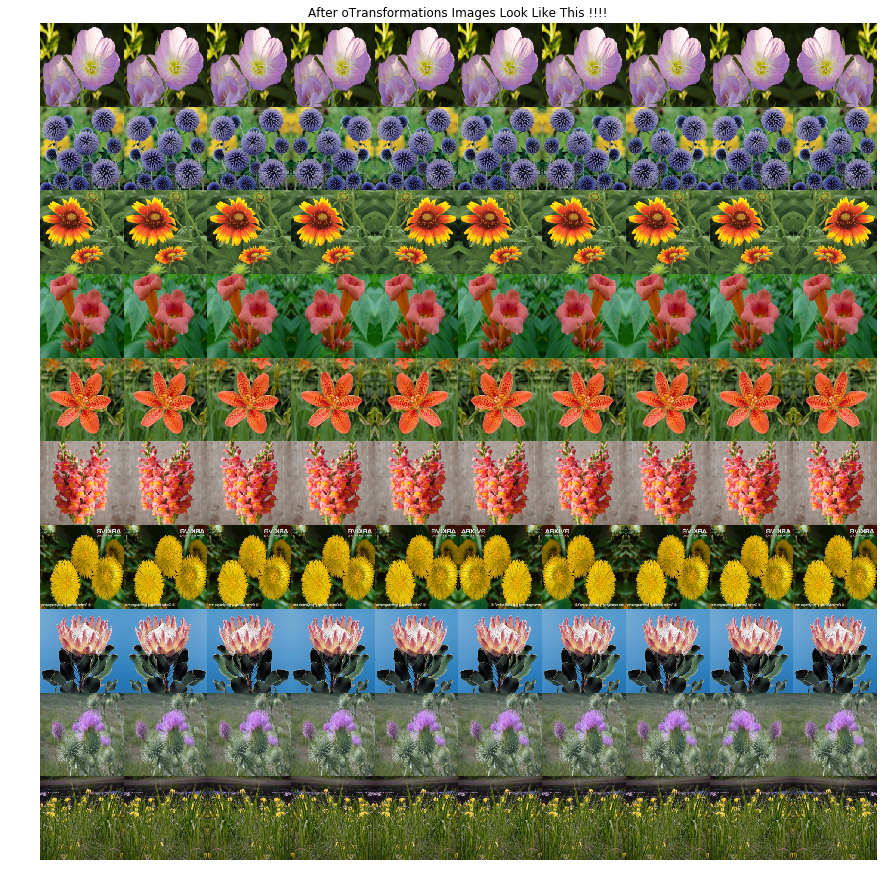

In [11]:
mpl.rcParams['figure.figsize'] = 15, 25

data_transforms_playground_2 = {
    'train': transforms.Compose([
    transforms.Resize((224,224)),
    transforms.RandomHorizontalFlip(.75)
    ])
}

dataset = torchvision.datasets.ImageFolder('google_data/', transform=data_transforms_playground_2['train'])

def show_dataset(dataset, n=10):
  _, ax = plt.subplots()
  imgs = np.vstack((np.hstack((np.asarray(dataset[i][0]) for _ in range(n)))
                   for i in range(2, 102, 10)))
  plt.imshow(imgs)
  ax.set_title('After oTransformations Images Look Like This !!!!')
  plt.axis('off')

  
show_dataset(dataset)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  from ipykernel import kernelapp as app


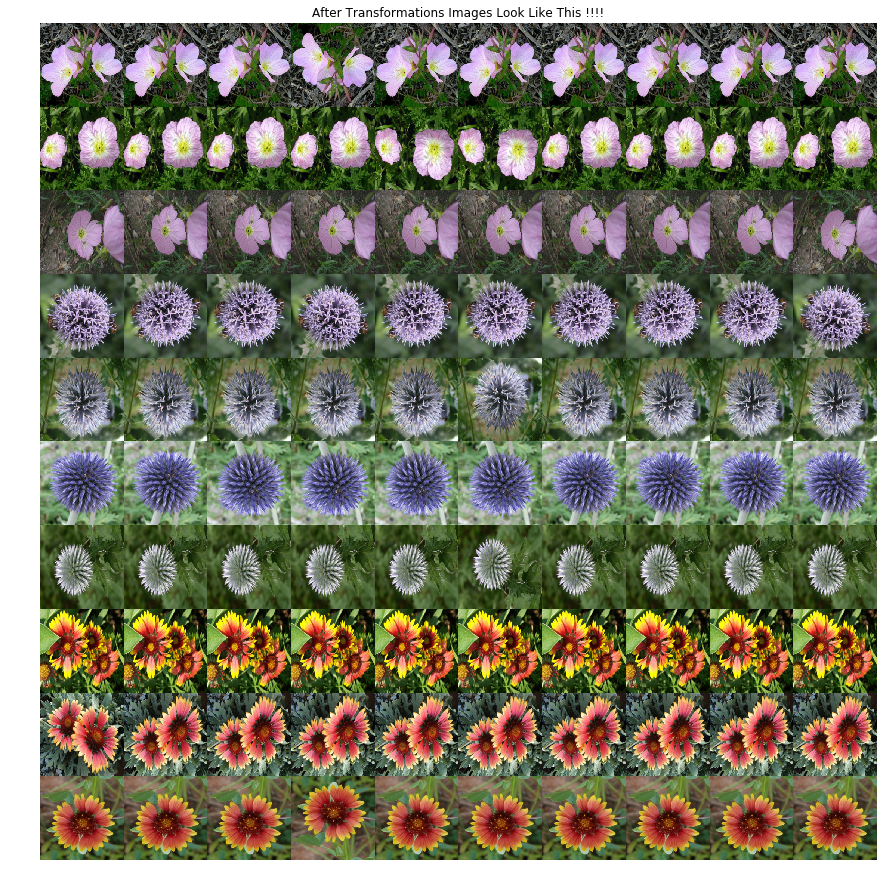

In [12]:
mpl.rcParams['figure.figsize'] = 15, 25

data_transforms_playground_3 = {
    'train': transforms.Compose([
    transforms.Resize((224,224)),
    transforms.RandomVerticalFlip(.75)
    ])
}

dataset = torchvision.datasets.ImageFolder('flower_data/train/', transform=data_transforms_playground_3['train'])

def show_dataset(dataset, n=10):
  _, ax = plt.subplots()
  imgs = np.vstack((np.hstack((np.asarray(dataset[i][0]) for _ in range(n)))
                   for i in range(3, 102, 10)))
  plt.imshow(imgs)
  ax.set_title('After Transformations Images Look Like This !!!!')
  plt.axis('off')

  
show_dataset(dataset)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  from ipykernel import kernelapp as app


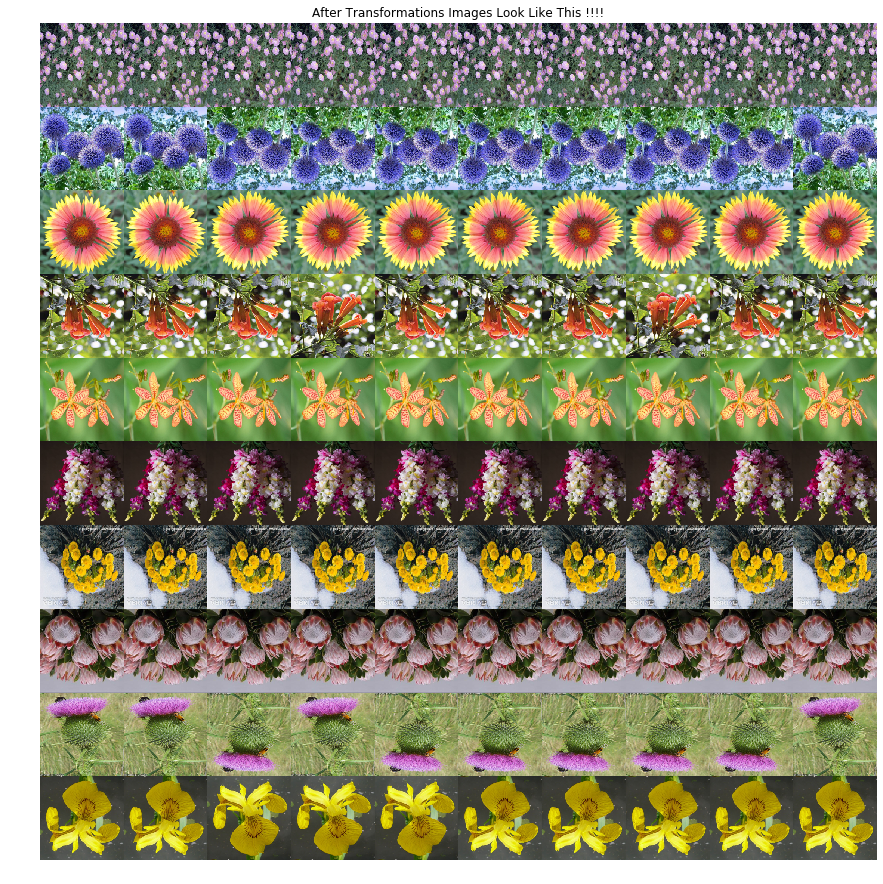

In [13]:
mpl.rcParams['figure.figsize'] = 15, 25

data_transforms_playground_3 = {
    'train': transforms.Compose([
    transforms.Resize((224,224)),
    transforms.RandomVerticalFlip(.75)
    ])
}

dataset = torchvision.datasets.ImageFolder('google_data/', transform=data_transforms_playground_3['train'])

def show_dataset(dataset, n=10):
  _, ax = plt.subplots()
  imgs = np.vstack((np.hstack((np.asarray(dataset[i][0]) for _ in range(n)))
                   for i in range(3, 102, 10)))
  plt.imshow(imgs)
  ax.set_title('After Transformations Images Look Like This !!!!')
  plt.axis('off')

  
show_dataset(dataset)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  app.launch_new_instance()


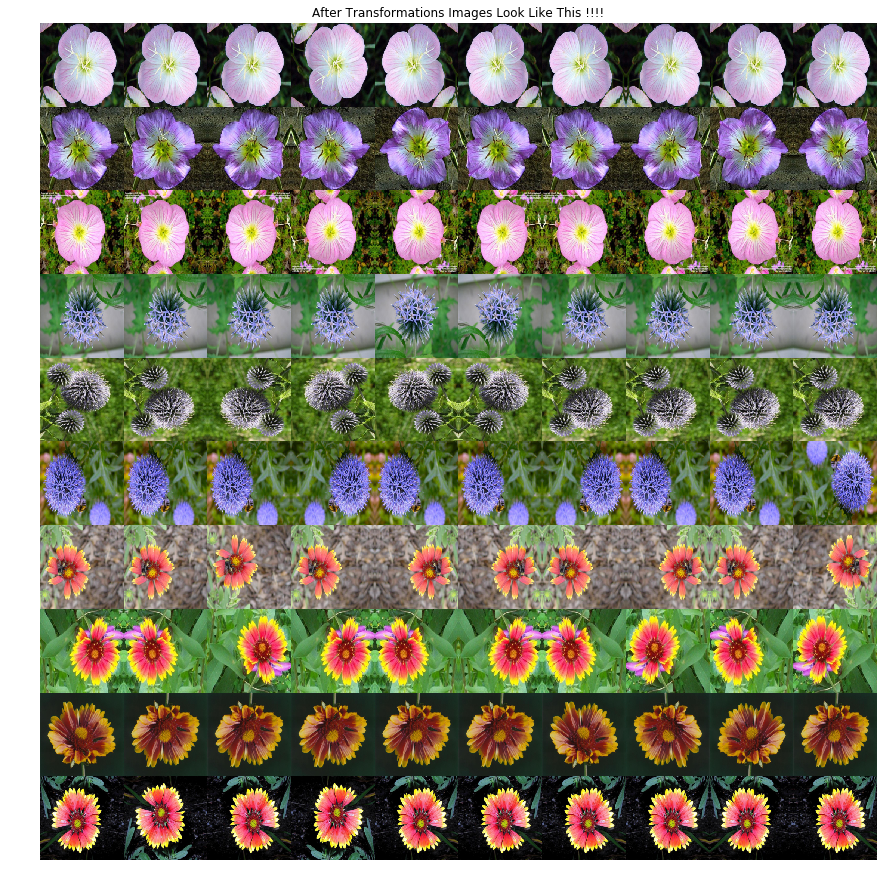

In [14]:
mpl.rcParams['figure.figsize'] = 15, 25

data_transforms_playground_4 = {
    'train': transforms.Compose([
    transforms.Resize((224,224)),
    transforms.RandomHorizontalFlip(.5),
    transforms.RandomVerticalFlip(.75)
    ])
}

dataset = torchvision.datasets.ImageFolder('flower_data/train/', transform=data_transforms_playground_4['train'])

def show_dataset(dataset, n=10):
  _, ax = plt.subplots()
  imgs = np.vstack((np.hstack((np.asarray(dataset[i][0]) for _ in range(n)))
                   for i in range(5, 102, 10)))
  plt.imshow(imgs)
  ax.set_title('After Transformations Images Look Like This !!!!')
  plt.axis('off')

  
show_dataset(dataset)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.


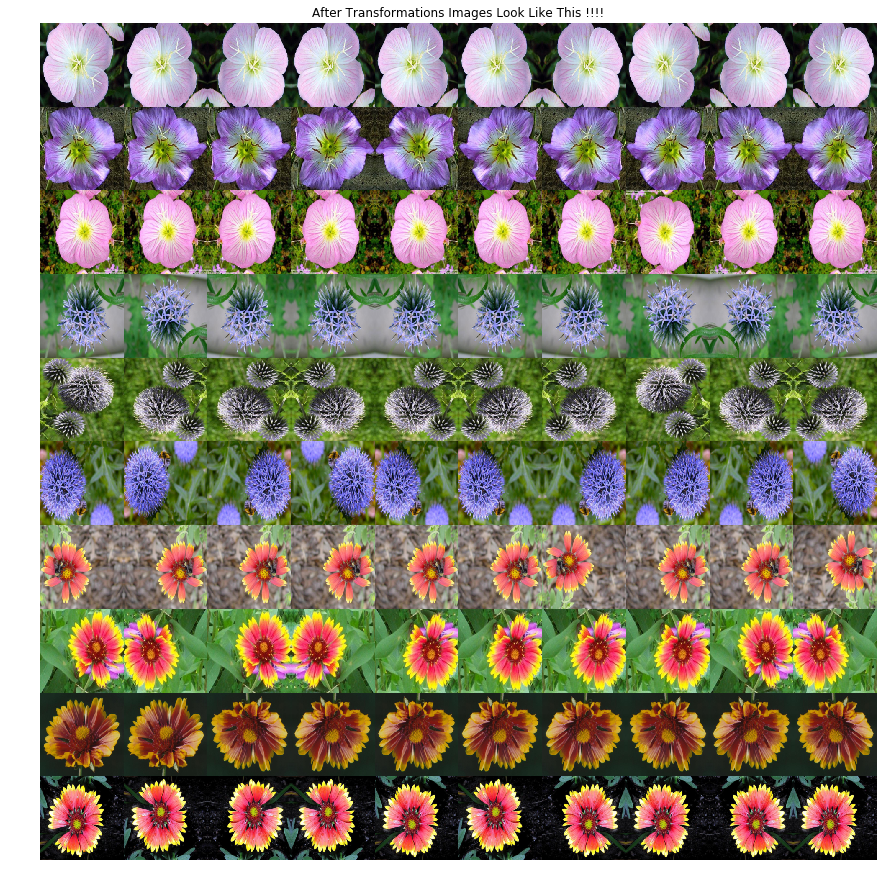

In [15]:
mpl.rcParams['figure.figsize'] = 15, 25

data_transforms_playground_4 = {
    'train': transforms.Compose([
    transforms.Resize((224,224)),
    transforms.RandomHorizontalFlip(.5),
    transforms.RandomVerticalFlip(.75),
    transforms.CenterCrop(200)
    ])
}

dataset = torchvision.datasets.ImageFolder('flower_data/train/', transform=data_transforms_playground_4['train'])

def show_dataset(dataset, n=10):
  _, ax = plt.subplots()
  imgs = np.vstack((np.hstack((np.asarray(dataset[i][0]) for _ in range(n)))
                   for i in range(5, 102, 10)))
  plt.imshow(imgs)
  ax.set_title('After Transformations Images Look Like This !!!!')
  plt.axis('off')

  
show_dataset(dataset)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:18: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.


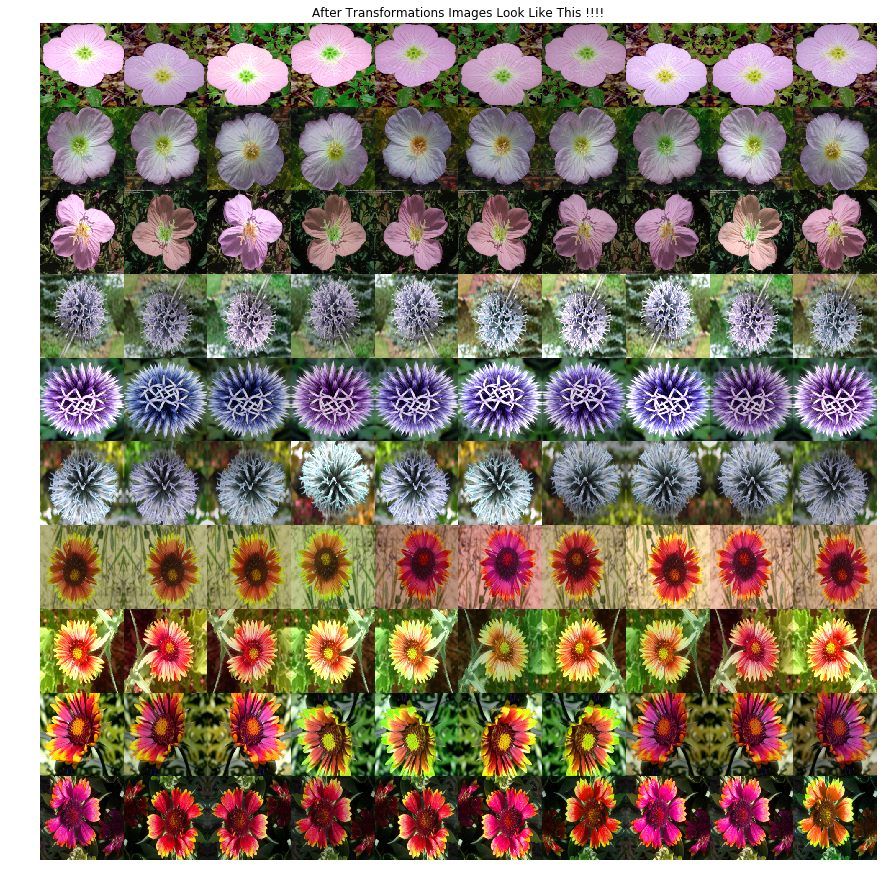

In [16]:
mpl.rcParams['figure.figsize'] = 15, 25

data_transforms_playground_5 = {
    'train': transforms.Compose([
    transforms.Resize((224,224)),
    transforms.RandomHorizontalFlip(.5),
    transforms.RandomVerticalFlip(.5),
    transforms.CenterCrop(200),
    transforms.ColorJitter(brightness=0.2, hue=.1, saturation=.1)
    ])
}

dataset = torchvision.datasets.ImageFolder('flower_data/train/', transform=data_transforms_playground_5['train'])

def show_dataset(dataset, n=10):
  _, ax = plt.subplots()
  imgs = np.vstack((np.hstack((np.asarray(dataset[i][0]) for _ in range(n)))
                   for i in range(6, 102, 10)))
  plt.imshow(imgs)
  ax.set_title('After Transformations Images Look Like This !!!!')
  plt.axis('off')

  
show_dataset(dataset)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  app.launch_new_instance()


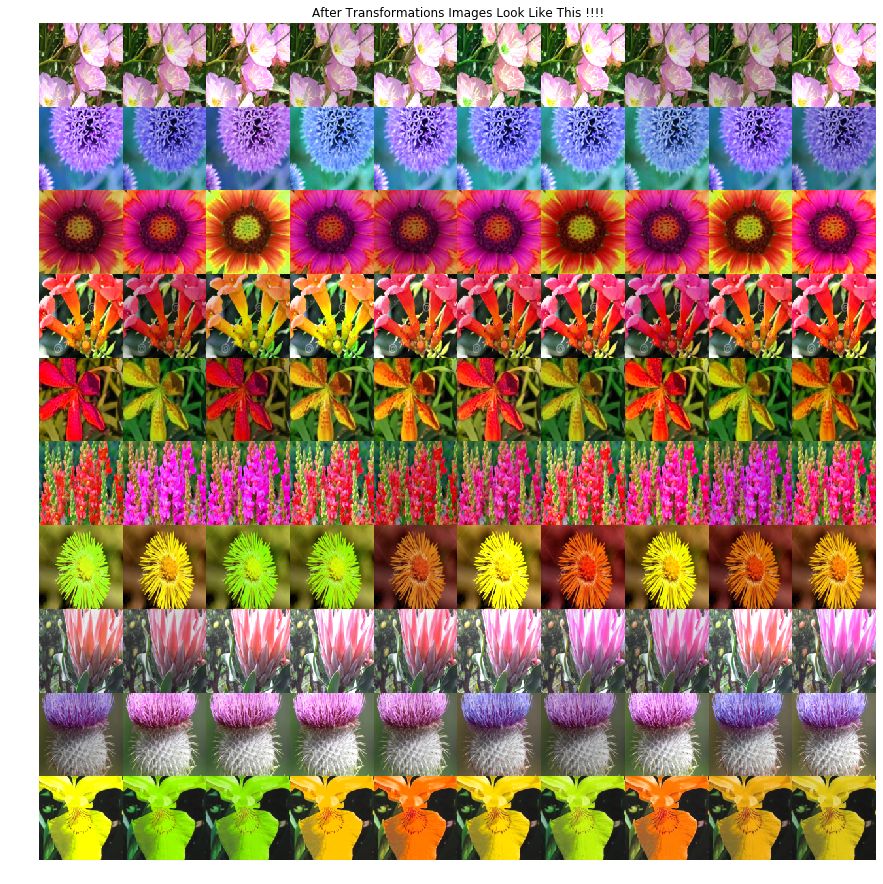

In [17]:
mpl.rcParams['figure.figsize'] = 15, 25

data_transforms_playground_6 = {
    'train': transforms.Compose([
    transforms.Resize((224,224)),
    transforms.CenterCrop(128),#matters
    transforms.ColorJitter(brightness=0.2, hue=.1, saturation=.1)
    ])
}

dataset = torchvision.datasets.ImageFolder('google_data/', transform=data_transforms_playground_6['train'])

def show_dataset(dataset, n=10):
  _, ax = plt.subplots()
  imgs = np.vstack((np.hstack((np.asarray(dataset[i][0]) for _ in range(n)))
                   for i in range(7, 102, 10)))
  plt.imshow(imgs)
  ax.set_title('After Transformations Images Look Like This !!!!')
  plt.axis('off')

  
show_dataset(dataset)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  app.launch_new_instance()


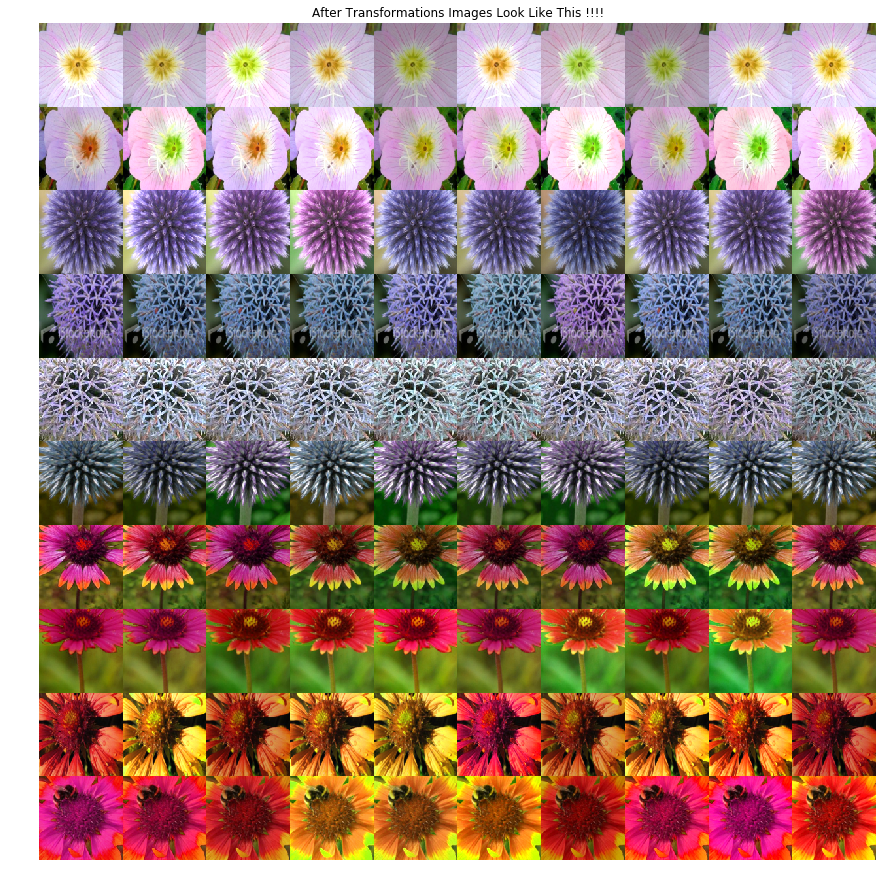

In [18]:
mpl.rcParams['figure.figsize'] = 15, 25

data_transforms_playground_6 = {
    'train': transforms.Compose([
    transforms.Resize((224,224)),
    transforms.CenterCrop(128),#matters
    transforms.ColorJitter(brightness=0.2, hue=.1, saturation=.1)
    ])
}

dataset = torchvision.datasets.ImageFolder('flower_data/train/', transform=data_transforms_playground_6['train'])

def show_dataset(dataset, n=10):
  _, ax = plt.subplots()
  imgs = np.vstack((np.hstack((np.asarray(dataset[i][0]) for _ in range(n)))
                   for i in range(7, 102, 10)))
  plt.imshow(imgs)
  ax.set_title('After Transformations Images Look Like This !!!!')
  plt.axis('off')

  
show_dataset(dataset)